<a href="https://colab.research.google.com/github/PauloHMattos/cos360-optimization/blob/main/Notebook.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Códigos auxiliares

In [ ]:
%matplotlib inline

In [ ]:
import math
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
import matplotlib.ticker as plticker
from matplotlib import cm, colors
from IPython.display import HTML, display, clear_output
from matplotlib import animation, rc
import ipywidgets as widgets
from IPython.display import display
rc('animation', html='jshtml')

### Display de tabela

In [ ]:
def display_results(table_name, results_data):
    results = {
        'X0': [],
        'Max. Rho': [],
        'Iter. Penal.': [],
        'Iter. Method': [],
        'Call. Armijo': [],
        'Opt. Point': [],
        'Opt. Value': [],
        'Error': [],
        'Feasible': [],
    }

    for data in results_data:
        results['X0'].append(data[0])
        results['Iter. Penal.'].append(data[9])
        results['Iter. Method'].append(data[1])
        results['Call. Armijo'].append(data[2])
        results['Opt. Point'].append(data[3])
        results['Opt. Value'].append(data[5])
        results['Error'].append(abs(data[6]))
        results['Max. Rho'].append(data[7])
        results['Feasible'].append(data[8])
    
    rows_count = 0
    html = "<center><table border='1' align='center'>"
    html += "<tr><th colspan=%d>%s</th></tr>" % (len(results), table_name)
    # Colum Headers
    html += "<tr>"
    for column in results:
        colName = column
        if (column == "X0"):
            colName = 'X<sup>0</sup>'
        elif (column == "Error"):
            colName = 'Error (|&nabla;f(x)|)'
        html += "<th><b>%s</b></th>" % (colName)
        rows_count = max(rows_count, len(results[column]))
    html += "</tr>"

    for i in range(rows_count):
        html += "<tr>"
        for column in results:
            data = results[column][i]
            html += "<td>%s</td>" % (data)
        html += "</tr>"
    html += "</table></center>"
    display(HTML(html))


### Funções de gráficos

In [ ]:
def spherical_to_cartesian(phi, theta, r=1):
    x_1 = r * np.cos(phi) * np.sin(theta)
    x_2 = r * np.sin(phi) * np.sin(theta)
    x_3 = r  *np.cos(theta)
    return x_1, x_2, x_3
    
def cartesian_to_spherical(x, y, z):
    XsqPlusYsq = x*x + y*y

    r = math.sqrt(XsqPlusYsq + z*z)
    theta = math.atan2(math.sqrt(XsqPlusYsq), z) 
    phi = math.atan2(y, x)

    phi = (2*np.pi + phi) * (phi < 0) + phi*(phi > 0)
    theta = (2*np.pi + theta) * (theta < 0) + theta*(theta > 0)
    return r, phi, theta

In [ ]:
def obj_func_sphere(phi, theta):
    x_1, x_2, x_3 = spherical_to_cartesian(phi, theta)
    return x_1**3 + x_1**2 * x_2+ x_1 * x_2**2 + x_2**3 + x_1 * x_2 * x_3 + x_3**3 + x_2 * x_3**2 

def plot_level_curves(ax, phi, theta, fob, cmap, title='Curvas de nivel'):
    loc = plticker.MultipleLocator(base=0.2) # this locator puts ticks at regular intervals
    CS = ax.contourf(phi, theta, fob, cmap=cmap, locator=loc)
    ax.set_aspect(2)
    ax.set_title(title)
    ax.set_xlabel(r'$\theta$')
    ax.set_ylabel(r'$\phi$')
    plt.colorbar(CS, shrink=0.25, aspect=10)
    return CS
    
def plot_domain(ax, phi, theta, fob, cmap):
    ax.set_title('Dominio $\Omega$')
    ax.set_xlabel(r'$x_1$')
    ax.set_ylabel(r'$x_2$')
    ax.set_zlabel(r'$x_3$')
    
    x, y, z = spherical_to_cartesian(phi, theta)
    
    strength = obj_func_sphere(phi, theta)
    norm=colors.Normalize(vmin = np.min(strength), vmax = np.max(strength), clip = False)
    
    dplot = ax.plot_surface(y, x, z, facecolors=cmap(norm(strength)))

    m = cm.ScalarMappable(cmap=cmap, norm=norm)
    m.set_array([])
    plt.colorbar(m, shrink=0.25, aspect=10)

def plot_function(fig, phi, theta, fob, cmap):
    ax = fig.add_subplot(1, 3, 2, projection='3d')
    ax.set_xlabel(r'$\phi$')
    ax.set_ylabel(r'$\theta$')
    ax.set_title('Função objetivo no dominio $\Omega$')
    

    dplot = ax.plot_surface(theta, phi, fob, cmap=cmap)
    plt.colorbar(dplot, shrink=0.25, aspect=10)

    ax = fig.add_subplot(1, 3, 3)
    plot_level_curves(ax, phi, theta, fob, cmap)

def plot_function_r3(cmap):
    x = (np.random.rand(3,5000) -0.5) * 100
    x_1 = x[0]
    x_2 = x[1]
    x_3 = x[2]
    fob = x_1**3 + x_1**2 * x_2+ x_1 * x_2**2 + x_2**3 + x_1 * x_2 * x_3 + x_3**3 + x_2 * x_3**2

    fig = plt.figure(clear=True, figsize=(14, 7))
    ax = fig.add_subplot(111, projection='3d')
    ax.set_xlabel(r'$x_1$')
    ax.set_ylabel(r'$x_2$')
    ax.set_zlabel(r'$x_3$')
    ax.set_title('Função objetivo no R³')
    
    dplot = ax.scatter(x_1, x_2, x_3, c=fob, cmap=cmap, marker='o')
    plt.colorbar(dplot, shrink=0.5, aspect=10)
    plt.show()

In [ ]:
def update(i, line, phi, theta):
    x = phi[i]
    y = theta[i]

    x_data = np.append(line.get_xdata(), x)
    y_data = np.append(line.get_ydata(), y)

    line.set_data(x_data, y_data)
    return (line,)

In [ ]:
def display_descent(title, params_history, theta_grid, phi_grid, fob, cmap):
    fig, ax = plt.subplots()
    last_added = params_history[0]
    r, phi, theta = cartesian_to_spherical(*last_added)
    evolution_phi = [phi]
    evolution_theta = [theta]
    count = len(params_history)
    for i in range(1, count):
        p = params_history[i]

        # Pular pontos muito proximos pra evitar que a animação seja muito grande
        if i != count and np.linalg.norm(p - last_added) <= 10**-4:
            continue
        
        last_added = p
        r, phi, theta = cartesian_to_spherical(*last_added)
        evolution_phi.append(phi)
        evolution_theta.append(theta)
        
    line, = ax.plot([], [], 'k--')

    cont = plot_level_curves(ax, phi_grid, theta_grid, fob, cmap, title)
    circle_rad = 10
    ax.plot(evolution_phi[0], evolution_theta[0], 'o', ms=circle_rad * 2, mec='r', mfc='none', mew=2)
    ax.plot(evolution_phi[-1], evolution_theta[-1], 'o', ms=circle_rad * 2, mec='b', mfc='none', mew=2)

    anim = animation.FuncAnimation(fig, update, fargs=(line, evolution_phi, evolution_theta),
                               frames=len(evolution_phi), interval=60, blit=True)
    return anim

In [ ]:
def animate_descent(results, cmap):
    button = widgets.Button(description="Gerar animações")
    output = widgets.Output()

    def on_button_clicked(b):
        with output:
            clear_output()
            print("Gerando animações. Esse processo demora um pouco")

        theta_grid, phi_grid = np.meshgrid(np.linspace(0, np.pi, 512), np.linspace(0, 2 * np.pi, 512))
        fob = obj_func_sphere(phi_grid, theta_grid)

        for r in results:
            params_history = r[4]
            a = display_descent(str(r[0]), params_history, theta_grid, phi_grid, fob, cmap)
            plt.close()
            with output:
                display(a)

    button.on_click(on_button_clicked)
    display(button, output)

In [ ]:
def plot_function_analisys():
    plt.rc('xtick', labelsize=10)
    plt.rc('ytick', labelsize=10)
    plt.rc('axes', titlesize=18)
    plt.rc('axes', labelsize=18)

    phi, theta = np.meshgrid(np.linspace(0, 2*np.pi, 512), np.linspace(0, np.pi, 512))
    fob = obj_func_sphere(phi, theta)

    cmap = cm.summer
    fig = plt.figure(clear=True, figsize=(18, 5))
    ax = fig.add_subplot(1, 3, 1, projection='3d', adjustable='box')
    plot_domain(ax, phi, theta, fob, cmap)
    plot_function(fig, phi, theta, fob, cmap)

    plt.show()

# Analise da Função


A função objetivo e seu dominio são:
\begin{equation}
f(x_1, x_2, x_3) = x_1^3 + x_1^2 x_2 + x_1 x_2^2 + x_2^3 + x_1 x_2 x_3 + x_3^3 + x_2 x_3^2 
\end{equation}
\begin{equation}
\Omega = \{ x \in R^3 :  \sqrt{ x_1^2 + x_2^2 + x_3^2} = 1 \}
\end{equation}

Analisando a função podemos dizer que ela é contínua, porém não coerciva, pois $lim_{x\to\infty} = \infty$ e $lim_{x\to-\infty} = -\infty$. Com isso não temos a presença de um mínimo global em um domínio irrestrito.

Ao mesmo tempo considerando que nosso domínio $\Omega$ restrito é fechado e limitado, podemos dizer que há presença de um mínimo global de $f(x_1, x_2, x_3)$ dentro de $\Omega$, que calcularemos neste trabalho a partir de métodos computacionais.

## Plotagem da função

Por se tratar de uma função $R^3 \to R$, ela foi plotada como uma dispersão. As cores indicam o valor da função objetivo no ponto.

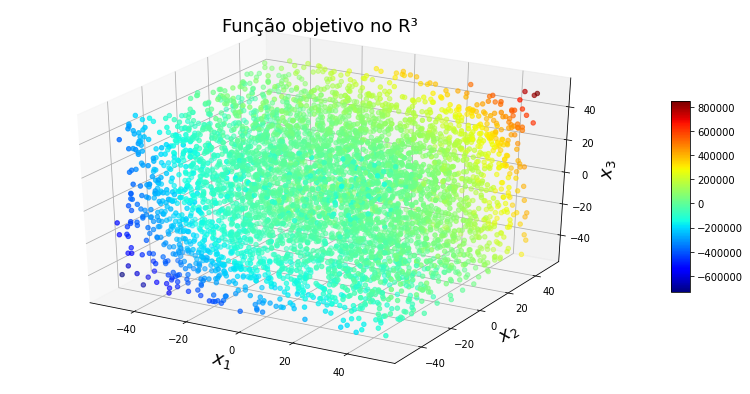

In [ ]:
#@title Gráfico de dispersão da Função Objetivo {display-mode: "form"}

plot_function_r3(cm.jet)

Mas para uma visualização melhor do comportamento da função, podemos limita-la ao seu dominio e plota-la.

O dominio $\Omega$ representa a superfície de uma esfera de raio 1, logo podemos parametrizar esse problema utilizando coordenadas esféricas, o que simplifica consideravelmente a plotagem dessa função:

\begin{equation}
\begin{split}
x_1=r.\sin(\phi).\cos(\theta) \\
x_2=r.\sin(\phi).\sin(\theta) \\
x_3=r.\cos(\phi)
\end{split}
\end{equation} 

Onde:
\begin{equation}
r=1 \\
0 \le \theta \le 2\pi \\
0 \le \phi \le \pi
\end{equation} 

Assim, a função objetivo pode ser reescrita como uma função $R^2 \rightarrow R$, tendo como parâmetros apenas $\phi$ e $\theta$:

\begin{equation}
\begin{split}
f(\phi, \theta) = &\ \sin(\phi).\cos^3(\theta) + \\
&\ \sin(\phi).\cos^2(\theta) \sin(\phi).\sin(\theta) + \\
&\ \sin(\phi).\cos(\theta) \sin(\phi).\sin^2(\theta) + \\
&\ \sin(\phi).\sin^3(\theta) + \\
&\ \sin(\phi).\cos(\theta) \sin(\phi).\sin(\theta) \cos(\theta) + \\
&\ \cos^3(\theta) + \\
&\ \sin(\phi).\sin(\theta)\cos^2(\theta)
\end{split}
\end{equation}

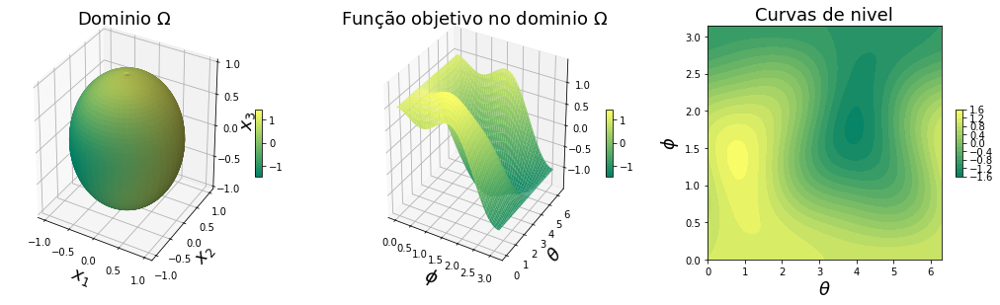

In [ ]:
#@title Gráficos da Função Objetivo restrita ao dominio {display-mode: "form"}

plot_function_analisys()

Apesar da parametrização utilizando coordenadas esféricas já introduzir as restrições no problema e reduzir o número de variáveis do problema, optamos por resolver o problema em dua forma original utilizando outras técnicas.

Isso pois a função é uma polinomial relativamente simples em sua forma original, e em coordenadas esféricas se torna muito mais complicada.

## Analise de pontos críticos

Fazendo o gradiente da função objetivo $\nabla f (x_1,x_1, x_1)$ em relação a 
$[x_1, x_1, x_3]^T$ temos:

\begin{gather}
\begin{bmatrix} 
\frac{\delta f}{\delta x_1} \\ 
\frac{\delta f}{\delta x_1} \\
\frac{\delta f}{\delta x_1} 
\end{bmatrix}
=
\begin{bmatrix}
3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3) \\
x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3) \\
x_1 x_2 + x_3 (2 x_2 + 3 x_3)
\end{bmatrix}
\end{gather}
<br/>
<br/>
Igualando o gradiente a zero, pode-se obter possiveis pontos críticos para a função objetivo:

\begin{gather}
\begin{bmatrix}
3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3) \\
x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3) \\
x_1 x_2 + x_3 (2 x_2 + 3 x_3)
\end{bmatrix}
= 
\begin{bmatrix}
{0} \\
{0} \\
{0} \\
\end{bmatrix}
\end{gather}
<br/>
<br/>
Resultando no sistema de equaçãoes não lineares abaixo:
\begin{equation}
    \begin{cases}
      3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3) = 0 \\
      x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3) = 0 \\
      x_1 x_2 + x_3 (2 x_2 + 3 x_3) = 0
    \end{cases}
\end{equation}
<br/>
<br/>
A solução desse sistema indica um unico ponto crítico na função objetivo. O ponto $x = [0, 0, 0]^T$, que é inválido pois está fora do dominio $\Omega$.



## Analise de convexidade

O dominio $\Omega$ é a superficie de uma esfera, portanto não é convexo.

Para determinar a convexidade da função é necessário calcular a matriz Hessiana da função objetivo:

\begin{gather}
\nabla^2 f(x_1,x_2,x_3) = 
\begin{bmatrix} 
\frac{\delta^2 f}{\delta x_1 x_1} & \frac{\delta^2 f}{\delta x_1 x_2} & \frac{\delta^2 f}{\delta x_1 x_3} \\
\frac{\delta^2 f}{\delta x_2 x_1} & \frac{\delta^2 f}{\delta x_2 x_2} & \frac{\delta^2 f}{\delta x_2 x_3} \\
\frac{\delta^2 f}{\delta x_3 x_1} & \frac{\delta^2 f}{\delta x_3 x_2} & \frac{\delta^2 f}{\delta x_3 x_3}
\end{bmatrix}
=
\begin{bmatrix} 
6 x_1 + 2 x_2 & 2 x_1 + 2 x_2 + x_3 & x_2 \\
2 x_1 + 2 x_2 + x_3 & 2 x_1 + 6 x_2 & x_1 + 2 x_3 \\
x_2 & x_1 + 2 x_3 & 2x_2 + 6x_3
\end{bmatrix}
\end{gather}
<br/>
A matrix Hessiana não é semi-definida positiva definida pois seus auto-valores não são todos não negativos para todos os seus auto-valores de $(x_1, x_2, x_3)$. Logo a função não é convexa no R³.

Dessa forma, a função objetivo desse problema não é convexa nem no R³ e nem em $\Omega$

---

Link para os auto-valores: [Wolfram Alpha](https://www.wolframalpha.com/input/?i=eigenvalues+of+%7B%7B6+x_1+%2B+2+x_2%2C+2+x_1+%2B+2+x_2+%2B+x_3%2C+x_2%7D%2C+%7B2+x_1+%2B+2+x_2+%2B+x_3%2C+2+x_1+%2B+6+x_2%2C+x_1+%2B+2+x_3%7D%2C+%7Bx_2%2C+x_1+%2B+2+x_3%2C+2+x_2+%2B+6+x_3%7D%7D)

## Otimalidade

### Condições de Karush–Kuhn–Tucker

Antes de resolver o sistema KKT, é necessário verificar que suas condições são respeitadas pelo problema.  
<br/>
Utilizando a condição de qualificação de independência linear (LIQC - Linear Independence Constraint Qualification), que é satisfeita em $\overline{x}$ quando o conjunto formado pelos gradientes das restrições de igualdade  e das restrições de desigualdade ativas é linearmente independentes:

\begin{equation}
\{\nabla h_i \in I_H\} \cup \{\nabla g_i\in I(\overline{x})\} \mbox{ é LI}
\end{equation}
<br/>
O problema analisado nesse trabalho apresenta apenas uma restrição de igualdade, logo apenas um gradiente. O grupo formado por apenas esse gradiente é por definição linearmente independente. Com isso a condição LIQC é verificada.  
<br/>
O método KKT resulta no seguinte sistema:

\begin{equation}
- \nabla f (x*)
=
\sum_{i \in I_H} \lambda_i \nabla h_i(x^*)
+
\sum_{i \in I_G} \mu_i^* \nabla g_i(x^*)
\end{equation}
\begin{equation}
\mu_i^* \ge 0, \forall i \in I_g \\ 
\mu_i^*, g_i(x^*) = 0, \forall i \in I_g \\
\end{equation}
<br/>

Aplicando o problema deste trabalho ao método, tem-se:
\begin{equation}
h_1 = (1 - x_1^2 + x_2^2 + x_3^2) \\
\nabla h_1 = [-2 x_1 \quad -2 x_2 \quad -2 x_3]^T
\end{equation}
<br/>
\begin{gather}
-
\begin{bmatrix}
3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3) \\
x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3) \\
x_1 x_2 + x_3 (2 x_2 + 3 x_3)
\end{bmatrix}
= 
\lambda_1
\begin{bmatrix}
-2 x_1 \\
-2 x_2 \\
-2 x_3
\end{bmatrix}
\end{gather}
<br/>
\begin{equation}
    \begin{cases}
      -(3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3)) = -2 \lambda_1 x_1 \\
      -(x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3)) = -2 \lambda_1 x_2\\
      -(x_1 x_2 + x_3 (2 x_2 + 3 x_3)) = -2 \lambda_1 x_3
    \end{cases}
\end{equation}
<br/>
<br/>
O que resulta em:
\begin{equation}
x^* = 
\begin{bmatrix}
0.310604 \lambda_1 \\
0.320832 \lambda_1 \\
0.0920951 \lambda_1
\end{bmatrix}
= 
\begin{bmatrix}
0.96812 \lambda_1 \\
\lambda_1 \\
0.287051 \lambda_1
\end{bmatrix}
\end{equation}

# Problema Restrito

A forma que o grupo escolheu para resolver o problema deste trabalho foi a utilização de métodos de penalização. Isso é devido a sua simplicidade em relação ao PQS. 
<br/>
<br/>
A estratégia desse tipo de método é converter o problema restrito em um irrestrito e depois utilizar um método para PNL irrestrita.
\begin{equation}
min \{f(x)\} \\
\text{s.a.  } H(X) = 0 \\
G(x) \le 0 \\
\end{equation}

Reescrevendo o problema:
\begin{equation}
min \{\theta(x, \rho) = f(x) + \rho P(x)\}
\end{equation}
<br/>
Onde $\rho$ é o parâmetro de penalidade e $P(x)$ é uma função de penalidade.

### Penalidade interna

No método de penalidade interior, a função objetivo é penalizada na região viável quando o ponto $x$ se aproxima da fronteira que limita esta região. Portante é um método que só pode ser utilizado em problemas com restrições de desigualdade.
<p/>
O método de penalidade interior não pode ser utilizado nessa problema, pois só apresenta uma unica restrição, que é de igualdade.

### Penalidade externa

Utilizando o método de penalidade exterior, a função objetivo é penalizada na região inviável, ou seja, quando alguma restrição é violada.
<br/>
<br/>
A função de penalização $P(x)$ utilizada neste trabalho para é a seguinte:
\begin{equation}
P(x) = \sum_{i=1}^{m}[h_i(x)] ^ 2 + \sum_{j=1}^{q}\{max[g_j(x)]\}^2
\end{equation}
<br/>
<br/>
Reescrevendo o problema do trabalho aplicando a função de penalidade tem-se:
\begin{equation}
\begin{split}
\theta(x_1, x_2, x_3, \rho) = &\ x_1^3 + x_1^2 x_2+ x_1 x_2^2 + x_2^3 + x_1 x_2 x_3 + x_3^3 + x_2 x_3^2 + \\
&\ \rho(x_1^2 + x_2^2 + x_3^2 - 1)^2
\end{split}
\end{equation}
<br/>
<br/>
\begin{gather}
\nabla \theta(x_1, x_2, x_3, \rho) 
= 
\begin{bmatrix}
3 x_1^2 + 2 x_1 x_2 + x_2 (x_2 + x_3) \\
x_1^2 + 3 x_2^2 + x_3^2 + x_1 (2 x_2 + x_3) \\
x_1 x_2 + x_3 (2 x_2 + 3 x_3)
\end{bmatrix}
+
\begin{bmatrix}
4 x_1 \rho (x_1^2 + x_2^2 + x_3^2 - 1) \\
4 x_2 \rho (x_1^2 + x_2^2 + x_3^2 - 1) \\
4 x_3 \rho (x_1^2 + x_2^2 + x_3^2 - 1)
\end{bmatrix}
\end{gather}
<br/>
<br/>
\begin{gather}
\nabla^2 \theta(x_1, x_2, x_3, \rho) = 
\begin{bmatrix} 
6 x_1 + 2 x_2 & 2 x_1 + 2 x_2 + x_3 & x_2 \\
2 x_1 + 2 x_2 + x_3 & 2 x_1 + 6 x_2 & x_1 + 2 x_3 \\
x_2 & x_1 + 2 x_3 & 2x_2 + 6x_3
\end{bmatrix}
+
\rho
\begin{bmatrix}
4 (x^2 + x_2^2 + x_3^2 - 1) + 8 x_1^2 & 8 x_1 x_2 & 8 x_1 x_3 \\
8 x_1 x_2 & 4 (x_1^2 + x_2^2 + x_3^2 - 1) + 8 x_2^2 & 8 x_2 x_3 \\
8 x_1 x_3 & 8 x_2 x_3 & 4 (x_1^2 + x_2^2 + x_3^2 - 1) + 8 x_3^2 \\
\end{bmatrix}
\end{gather}

# Minimização da função

## Codificação do problema

In [ ]:
def obj_function(params):
    x_1, x_2, x_3 = params
    return x_1**3 + x_1**2 * x_2 + x_1 * x_2**2 + x_2**3 + x_1 * x_2 * x_3 + x_3**3 + x_2 * x_3**2

def grad_function(params):
    x_1, x_2, x_3 = params
    return np.array([
        3 * x_1**2 + 2 * x_1 * x_2 + x_2 * (x_2 + x_3),
        x_1**2 + 3 * x_2**2 + x_3**2 + x_1 * (2 *x_2 + x_3),
        x_1 * x_2 + x_3 * (2 * x_2 + 3 * x_3)
    ])

def obj_function_hessian(params):
    x_1, x_2, x_3 = params
    return np.array([
        [6 * x_1 + 2 * x_2, 2 * x_1 + 2 * x_2 + x_3, x_2],
        [2 * x_1 + 2 * x_2 + x_3, 2 * x_1 + 6 * x_2, x_1 + 2 * x_3],
        [x_2, x_1 + 2 * x_3, 2 * x_2 + 6 * x_3]
    ])

In [ ]:
def is_feasible(tol):
    """Função que teste a viabilidade de parâmetros dentro de uma tolerância"""
    
    return lambda params : abs(1 - np.linalg.norm(params)) <= tol

In [ ]:
def obj_function_unconstrained(rho):
    def unconstrained(params):
        x_1, x_2, x_3 = params
        penalty = rho * (x_1**2 + x_2**2 + x_3**2 - 1)**2
        return obj_function(params) + penalty
    return unconstrained

def grad_function_unconstrained(rho):
    def unconstrained(params):
        x_1, x_2, x_3 = params
        common = (-1 + x_1**2 + x_2**2 + x_3**2)
        return grad_function(params) + rho * np.array([
            4 * x_1 * common,
            4 * x_2 * common,
            4 * x_3 * common
        ])
    return unconstrained

def obj_function_unconstrained_hessian(rho):
    def unconstrained(params):
        x_1, x_2, x_3 = params
        return obj_function_hessian(params) + rho * np.array([
            [8 * x_1**2 + 4 * (x_1**2 + x_2**2 + x_3**2 - 1), 8 * x_1 * x_2, 8 * x_1 * x_3],
            [8 * x_1 * x_2, 8 * x_2**2 + 4 * (x_1**2 + x_2**2 + x_3**2 - 1), 8 * x_2 * x_3],
            [8 * x_1 * x_3, 8 * x_2 * x_3, 8 * x_3**2 + 4 * (x_1**2 + x_2**2 + x_3**2 - 1)]
        ])
    return unconstrained

#### Funções de otimização

In [ ]:
def armijo(f, grad, param, d, gamma, eta):
    """
    Algoritmo de busca linear de Armijo
    Implementado de acordo com o contudo do slide COS360_NL_alg_descida.pdf
    """
    
    t = 1.0
    iter_count = 0
    f_param = f(param)
    graf_param_T = grad(param).T
    while f(param + t * d) > f_param + eta * t * np.dot(graf_param_T, d):
        t = t * gamma
        iter_count += 1
    
    return t, iter_count

In [ ]:
def run_constrained_optimization(rho, 
                                 beta, 
                                 optimization_method, 
                                 obj_function, 
                                 grad_func, 
                                 hessian, 
                                 feasible, 
                                 initi_params, 
                                 opt_func_params, 
                                 max_iter,
                                 min_diff_value):
    """
    Algoritmo de otimização restrita.
    Implementado de acordo com o contudo do slide COS360_NL_penalidade.pdf
    """

    total_iter_count = 0  # Número total de iterações do método de otimização
    total_armijo_count = 0 # Número total de iterações do método de armijo
    iter_count = 0 # Númeero de iterações do algoritmo de penalidade

    last_value = np.Infinity
    params = initi_params
    is_feasible = False
    full_history = []

    # Ser viável é requisito
    # Enquanto k < N
    while iter_count < max_iter or not is_feasible:
        last_params = params
        result = optimization_method(obj_function(rho), grad_func(rho), hessian(rho), params, *opt_func_params)
        total_iter_count += result[1]
        total_armijo_count += result[2]
        params = result[3]
        full_history = full_history + result[4]

        is_feasible = feasible(params)

        val = obj_function(rho)(params)
        # Se for viável e o valor da função não estiver mudando o suficiente
        # O valor convergiu e saimos do loop
        if (is_feasible and np.linalg.norm(last_value - val) < min_diff_value):
            break
    
        last_params = params
        last_value = val
        iter_count += 1
        
        rho = rho * beta
        if (rho > 10**9):
            break

    # Salva os dados para serem exibidos na tablea
    result[0] = initi_params
    result[1] = total_iter_count
    result[2] = total_armijo_count
    result.append(obj_function(0)(result[3]))
    result.append(np.linalg.norm(grad_func(0)(result[3])))
    result.append(rho)
    result.append(is_feasible)
    result.append(iter_count)
    # E o histórico completo de parâmetros para o plot da animação
    result[4] = full_history
    return result

In [ ]:
def run_method(optimization_method, start_params, method_params, max_iterations, tol, min_diff_value, rho, beta):
    """Método auxiliar usado para executar os métodos de otimização"""
    
    results = []
    start_params = [np.fromstring(p, sep=',') for p in start_params]

    # Fixa a tolerância para o teste de viabilidade
    feasible_func = is_feasible(tol)

    for params in start_params:
        # Executa a otimização para cada um dos pontos iniciais
        round_result = run_constrained_optimization(rho,
                                                    beta, 
                                                    optimization_method, 
                                                    obj_function_unconstrained, 
                                                    grad_function_unconstrained, 
                                                    obj_function_unconstrained_hessian, 
                                                    feasible_func,
                                                    np.array(params),
                                                    method_params,
                                                    max_iterations,
                                                    min_diff_value)
        # E agrupa os resultados
        results.append(round_result)
    return results

## Parâmetros

In [ ]:

#@title Digite os pontos iniciais desejados
initial_points_0 = "0, 0, 0" #@param {type:"string"}
initial_points_1 = "1, 0, 0" #@param {type:"string"}
initial_points_2 = "0, 1, 0" #@param {type:"string"}
initial_points_3 = "0, 0, 1" #@param {type:"string"}
initial_points_4 = "1, 0, 2" #@param {type:"string"}
initial_points_5 = "-0.5, -0.5, -0.5" #@param {type:"string"}
initial_points_6 = "0.5389488414, 0.8393630887, 0.07073720167" #@param {type:"string"}
initial_points_7 = "-100, -100, -100" #@param {type:"string"}
initial_points_8 = "100, 100, 100" #@param {type:"string"}
initial_points = [initial_points_0, initial_points_1, initial_points_2, initial_points_3, initial_points_4, initial_points_5, initial_points_6, initial_points_7, initial_points_8]

In [ ]:
#@title Penalização
rho = 2 #@param {type:"slider", min:0.5, max:50, step:0.25}
beta = 3 #@param {type:"slider", min:1.5, max:10, step:0.25}
max_iter_penalty = 10 #@param {type:"integer"}
feasibility_tolerance = 0.00001 #@param {type:"number"}
min_diff_params = 0.00001 #@param {type:"number"}
min_diff_value = 0.00001 #@param {type:"number"}

In [ ]:
#@title Método de otimização
max_iter_method = 75 #@param {type:"integer"}
min_diff_grad = 0.00001 #@param {type:"number"}


## Método de gradiente

### Código

In [ ]:
def gradient_descent(obj_func, 
                     grad_func,
                     hessian,
                     params_init,
                     armijo_params,
                     max_iterations,
                     epsilon,
                     min_diff_params):
    def calculate_direction(p):
        return -grad_func(p)

    params = params_init
    
    iter_count = 0
    armijo_iter_count = 0
    dir = calculate_direction(params)
    points_history = [params]
    
    # Enquanto número de iterações for menor que o máximo
    # E o gradiente no ponto atual for maior que o mínimo admissivel
    while iter_count < max_iterations and np.linalg.norm(dir) > epsilon:
        t, armijo_count = armijo(obj_func, grad_function, params, dir, *armijo_params)
        params = params + t * dir

        iter_count += 1
        armijo_iter_count += armijo_count
        dir = calculate_direction(params)
        points_history.append(params)

        # Se o os parâmetros não estiverem mudando provavelmente atingimos o mínimo
        if (np.linalg.norm(points_history[-2] - params) < min_diff_params):
            break
    
    return [params_init, iter_count, armijo_iter_count, params, points_history]

### Resultados

In [ ]:
#@title Armijo

armijo_gamma_gradient = 0.65 #@param {type:"slider", min:0.05, max:1, step:0.05}
armijo_eta_gradient = 0.05 #@param {type:"slider", min:0.05, max:1, step:0.05}

In [ ]:
#@title Tabela {display-mode: "form"}

gradient_method_results = run_method(gradient_descent, initial_points, [[armijo_gamma_gradient, armijo_eta_gradient], max_iter_method, min_diff_grad, min_diff_params],
                                     max_iter_penalty, feasibility_tolerance, min_diff_value, rho, beta)
display_results("Gradient Method", gradient_method_results)

#### Animações

In [ ]:
#@title Animações {display-mode: "form"}

animate_descent(gradient_method_results, cmap=cm.ocean)

Button(description='Gerar animações', style=ButtonStyle())

Output()

## Método de Newton

### Código

In [ ]:
def newton_method(obj_func, 
                  grad_func,
                  hessian,
                  params_init,
                  armijo_params,
                  max_iterations,
                  epsilon,
                  min_diff_params):
    
    def calculate_direction(p):
        return -np.dot(np.linalg.inv(hessian(p)), grad_func(p))

    params = params_init
    
    iter_count = 0
    armijo_iter_count = 0
    dir = calculate_direction(params)
    points_history = [params]
    
    # Enquanto número de iterações for menor que o máximo
    # E o gradiente no ponto atual for maior que o mínimo admissivel
    while iter_count < max_iterations and np.linalg.norm(dir) > epsilon:
        t, armijo_count = armijo(obj_func, grad_function, params, dir, *armijo_params)
        params = params + t * dir

        iter_count += 1
        armijo_iter_count += armijo_count
        dir = calculate_direction(params)
        points_history.append(params)

        # Se o os parâmetros não estiverem mudando provavelmente atingimos o mínimo
        if (np.linalg.norm(points_history[-2] - params) < min_diff_params):
            break

    return [params_init, iter_count, armijo_iter_count, params, points_history]

### Resultados

In [ ]:
#@title Armijo

armijo_gamma_newton = 0.65 #@param {type:"slider", min:0.05, max:5, step:0.05}
armijo_eta_newton = 0.25 #@param {type:"slider", min:0.05, max:5, step:0.05}

In [ ]:
#@title Tabela {display-mode: "form"}

newton_results = run_method(newton_method, initial_points, [[armijo_gamma_newton, armijo_eta_newton], max_iter_method, min_diff_grad, min_diff_params],
                            max_iter_penalty, feasibility_tolerance, min_diff_value, rho, beta)
display_results("Newton's Method", newton_results)

#### Animações

In [ ]:
#@title Animações {display-mode: "form"}

animate_descent(newton_results, cmap=cm.viridis_r)

Button(description='Gerar animações', style=ButtonStyle())

Output()

## Método Quase-Newton

### Código

In [ ]:
def quasi_newton_method(obj_func, 
                        grad_func,
                        hessian,
                        params_init,
                        hessian_estimator,
                        armijo_params,
                        max_iterations,
                        epsilon,
                        min_diff_params):
    
    def calculate_direction(B_I, grad):
        return -np.dot(B_I, grad)

    params = params_init
    
    iter_count = 0
    armijo_iter_count = 0
    B = np.identity(len(params))
    grad = grad_func(params)
    dir = calculate_direction(B, grad)
    points_history = [params]

    # Enquanto número de iterações for menor que o máximo
    # E o gradiente no ponto atual for maior que o mínimo admissivel
    while iter_count < max_iterations and np.linalg.norm(dir) > epsilon:
        t, armijo_count = armijo(obj_func, grad_function, params, dir, *armijo_params)
        last_params = params
        params = params + t * dir

        last_grad = grad
        grad = grad_func(params)
        B = hessian_estimator(B, params, last_params, grad, last_grad)
        dir = calculate_direction(B, grad)

        iter_count += 1
        armijo_iter_count += armijo_count
        points_history.append(params)
        
        # Se o os parâmetros não estiverem mudando provavelmente atingimos o mínimo
        if (np.linalg.norm(points_history[-2] - params) < min_diff_params):
            break

    return [params_init, iter_count, armijo_iter_count, params, points_history]

In [ ]:
def bfgs_estimator(hessian, params, last_params, grad, last_grad):
    I = np.eye(len(params), dtype=int)
    s = params - last_params
    y = grad - last_grad

    # Hack para evitar divisão por zero
    ro = 1.0 / max(np.dot(y, s), 10**-30)

    y_T = y[np.newaxis, :]
    y = y[:, np.newaxis]

    s_T = s[np.newaxis, :]
    s = s[:, np.newaxis]
    
    A1 = I - ro * s * y_T
    A2 = I - ro * y * s_T
    return np.dot(A1, np.dot(hessian, A2)) + (ro * s * s_T)

### Resultados

In [ ]:
#@title Armijo

armijo_gamma_q_newton = 0.65 #@param {type:"slider", min:0.05, max:5, step:0.05}
armijo_eta_q_newton = 0.05 #@param {type:"slider", min:0.05, max:5, step:0.05}

In [ ]:
#@title Tabela {display-mode: "form"}

quasi_newton_results = run_method(quasi_newton_method, initial_points, [bfgs_estimator, [armijo_gamma_q_newton, armijo_eta_q_newton], max_iter_method, min_diff_grad, min_diff_params],
                                  max_iter_penalty, feasibility_tolerance, min_diff_value, rho, beta)
display_results("Quasi-Newton's Method", quasi_newton_results)

#### Animações

In [ ]:
#@title Animações {display-mode: "form"}

animate_descent(quasi_newton_results, cmap=cm.PuRd_r)

Button(description='Gerar animações', style=ButtonStyle())

Output()